<a href="https://colab.research.google.com/github/Akhilesh-K-Yadav/First-Principles-of-Computer-Vision/blob/main/SIFT-Feature-Extraction/SIFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import numpy as np
import pickle
import argparse
import os
from time import time

In [ ]:
!ls -lh "/content/fountain-P11.zip"

-rw-r--r-- 1 root root 32M May 30 10:49 /content/fountain-P11.zip


In [ ]:
mkdir "/content/data"

In [ ]:
!unzip "/content/fountain-P11.zip" -d "/content/data/"

Archive:  /content/fountain-P11.zip
   creating: /content/data/fountain-P11/
   creating: /content/data/fountain-P11/gt_dense_cameras/
  inflating: /content/data/fountain-P11/gt_dense_cameras/0000.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0001.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0002.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0003.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0004.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0005.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0006.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0007.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0008.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0009.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0010.jpg.camera  
   creating: /content/data/fountain-P11/

In [ ]:
dir_path = "/content/data/fountain-P11/images/"

file_names = []
for file in os.listdir(dir_path):
  file_names.append(dir_path+file)
file_names.sort()


In [ ]:
file_names

['/content/data/fountain-P11/images/0000.jpg',
 '/content/data/fountain-P11/images/0001.jpg',
 '/content/data/fountain-P11/images/0002.jpg',
 '/content/data/fountain-P11/images/0003.jpg',
 '/content/data/fountain-P11/images/0004.jpg',
 '/content/data/fountain-P11/images/0005.jpg',
 '/content/data/fountain-P11/images/0006.jpg',
 '/content/data/fountain-P11/images/0007.jpg',
 '/content/data/fountain-P11/images/0008.jpg',
 '/content/data/fountain-P11/images/0009.jpg',
 '/content/data/fountain-P11/images/0010.jpg',
 '/content/data/fountain-P11/images/K.txt']

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
file_names[0]

'/content/data/fountain-P11/images/0000.jpg'

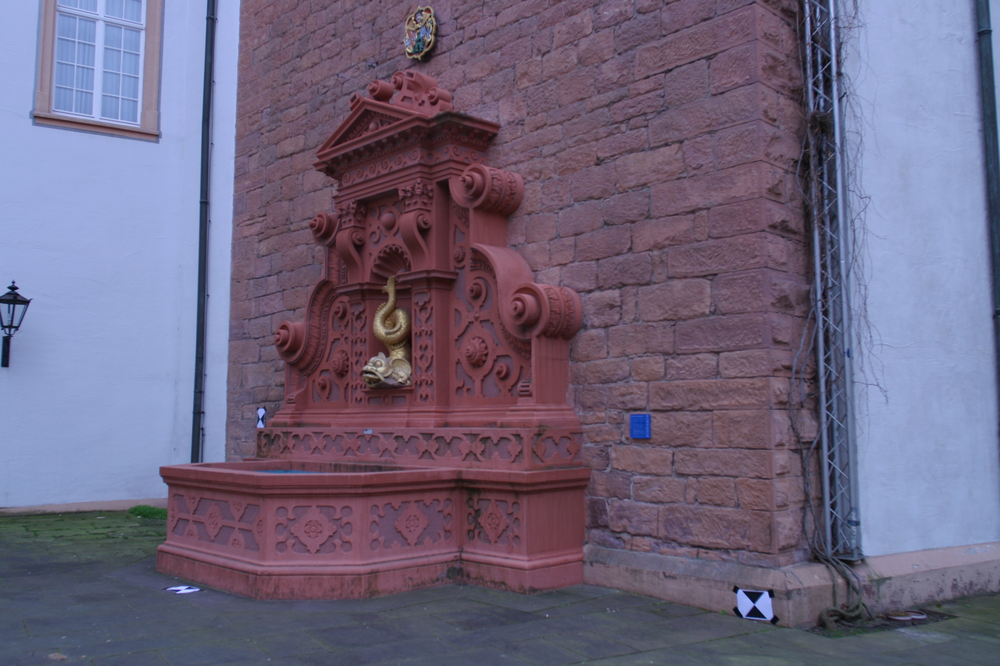

(2048, 3072, 3)

In [ ]:
img = cv2.imread(file_names[0])
cv2_imshow(img)
img.shape

In [29]:
img = img[:,:,::-1]

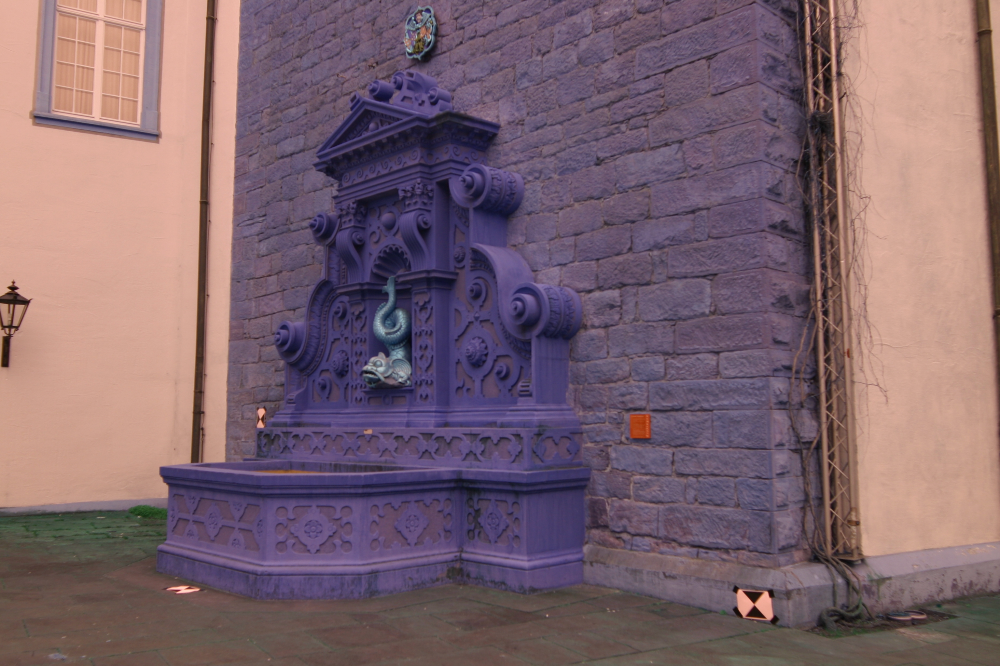

In [48]:
cv2_imshow(img)

In [36]:
feats = cv2.SIFT_create()
kp, desc = feats.detectAndCompute(img,None)

In [39]:
type(kp), type(desc)

(tuple, numpy.ndarray)

In [43]:
kp[0], len(kp), desc.shape

(< cv2.KeyPoint 0x793f3b487150>, 3870, (3870, 128))

In [49]:
img_out=cv2.drawKeypoints(img,kp,0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('sift_keypoints.jpg',img_out)

True

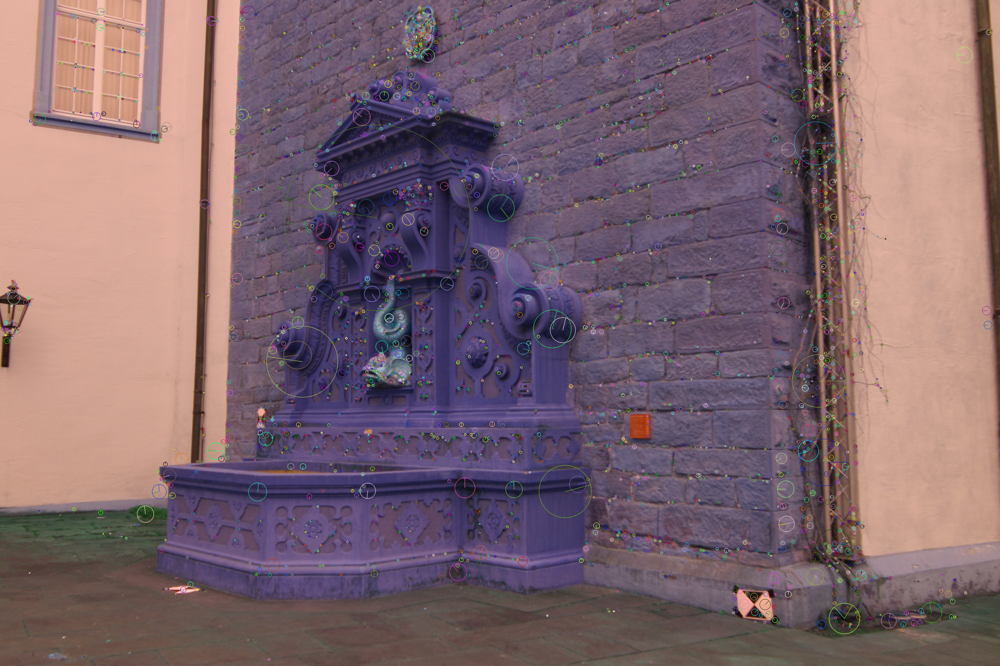

In [50]:
cv2_imshow(img_out)

(3798, 128)


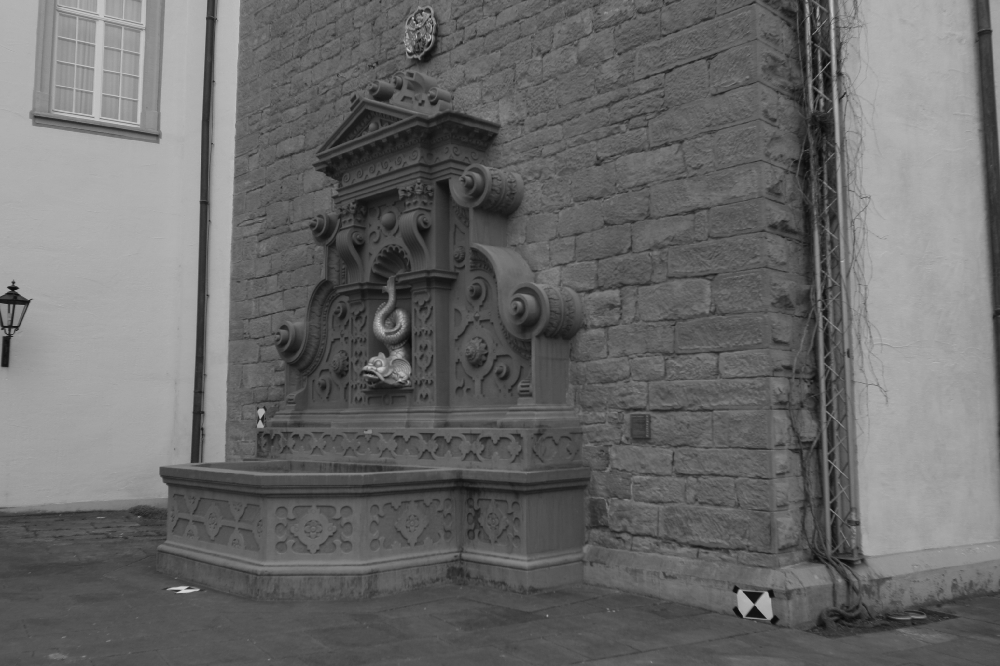

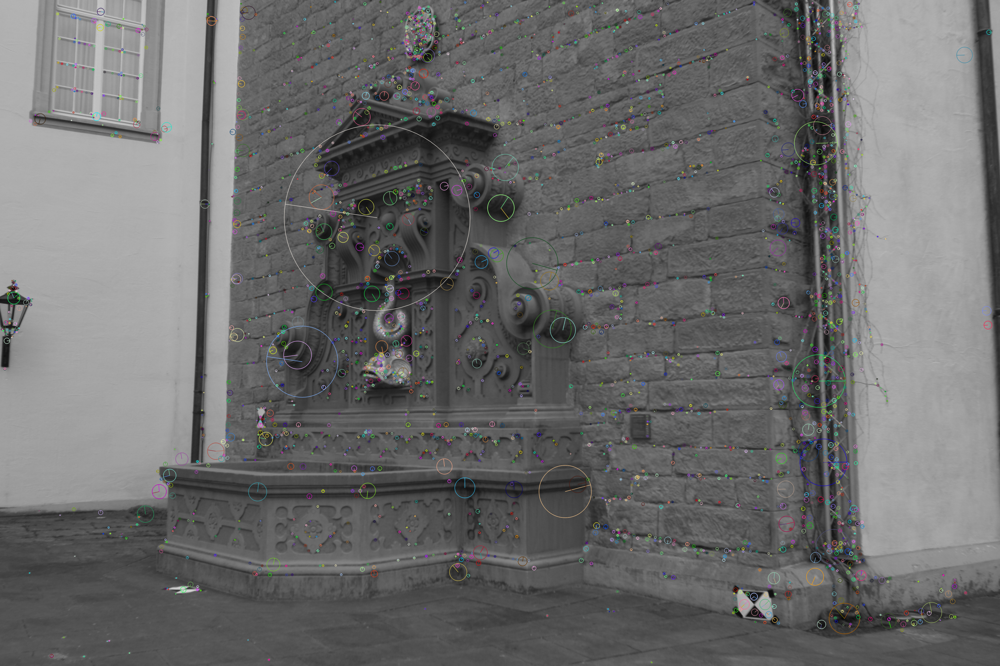

In [52]:
img_g = cv2.imread(file_names[0])
imagegray = cv2.cvtColor(img_g, cv2.COLOR_BGR2GRAY)
gray_feats = cv2.SIFT_create()
g_kp, g_desc = gray_feats.detectAndCompute(imagegray,None)
print(g_desc.shape)
img_out2=cv2.drawKeypoints(imagegray,kp,0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('sift_keypoints_gray.jpg',img_out2)
cv2_imshow(imagegray)
cv2_imshow(img_out2)

#               ***Grayscaling improves feature detection***